<a href="https://colab.research.google.com/github/Jakhongir0103/Gender_classification_model/blob/main/Gender_classification_model.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import fastai
import torch
from fastai.vision.all import *
from ipywidgets import widgets
from PIL import ImageFile

print(fastai.__version__)
print(torch.__version__)

2.7.9
1.12.1+cu113


In [ ]:
!git clone https://github.com/EscVM/OIDv4_ToolKit.git
!pip install -r /content/OIDv4_ToolKit/requirements.txt
# !python /content/OIDv4_ToolKit/main.py -h

Dataset used for prediction

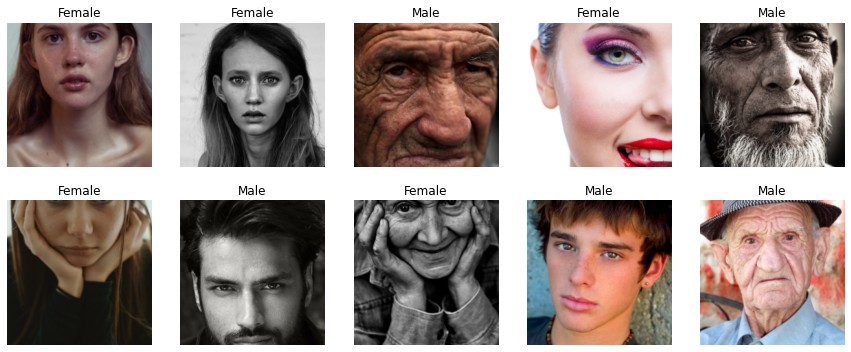

In [ ]:
# path
path = Path('/content/dataset/humans')

# datablock
db = DataBlock(
    blocks=(ImageBlock, CategoryBlock),
    get_items = get_image_files,
    get_y = parent_label,
    splitter = RandomSplitter(seed=42, valid_pct=0.2),
    item_tfms = Resize(224)
)

# dataloader
dls = db.dataloaders(path)

# visualize the data
ImageFile.LOAD_TRUNCATED_IMAGES=True
dls.train.show_batch(max_n=10, nrows=2)

In [ ]:
# train
humans_learner = cnn_learner(dls=dls, metrics=accuracy, arch=resnet34)
humans_learner.fine_tune(4)

/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


/usr/local/lib/python3.7/dist-packages/PIL/Image.py:960: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  "Palette images with Transparency expressed in bytes should be "


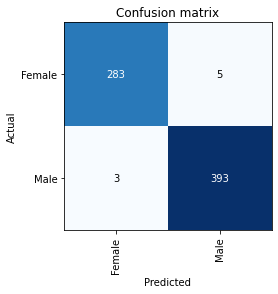

In [ ]:
# evaluation
interp = ClassificationInterpretation.from_learner(humans_learner)
interp.plot_confusion_matrix()

In [ ]:
# test the model
upload = widgets.FileUpload()
upload

FileUpload(value={}, description='Upload')

Prediction: Male
Probability: 100.0%


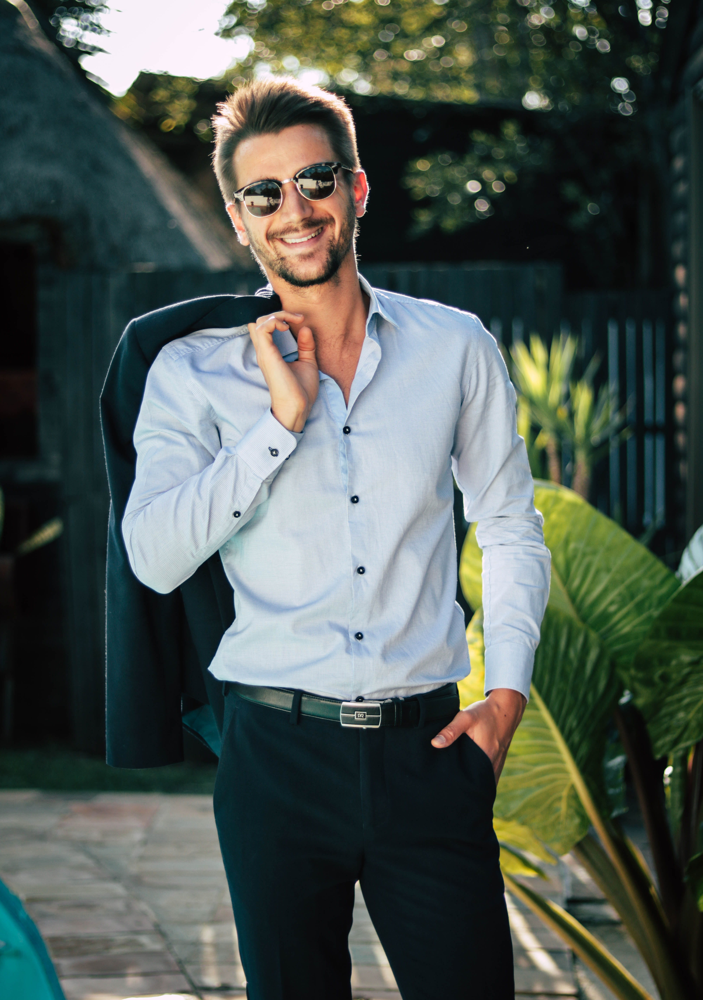

In [16]:
img = PILImage.create(upload.data[-1])
pred, pred_id, probs = humans_learner.predict(img)
print(f'Prediction: {pred}')
print(f'Probability: {probs[pred_id]*100:.1f}%')
img

In [17]:
humans_learner.export('humans.pkl')